## Visualization of Feature Activations

- Used SAEDashboard from Jbloom to generate all Features for Dashboard.  
- Output are the jsons pre Batch (128 Features from Batch)
- Reason to go this way - is to understand how the dashboards are generated and to generate automatic features using GPT4

In [1]:
import json

with open('batch-0.json', 'r') as file:
    batch_data = json.load(file)

In [2]:
min_feature_index = min(feature['feature_index'] for feature in batch_data["features"])
print(f"The minimal feature_index is: {min_feature_index}")
max_feature_index = max(feature['feature_index'] for feature in batch_data["features"])
print(f"The maximal feature_index is: {max_feature_index}")

The minimal feature_index is: 0
The maximal feature_index is: 127


In [3]:
batch_data.keys()

dict_keys(['model_id', 'layer', 'sae_set', 'features'])

In [4]:
batch_data['features'][0].keys()

dict_keys(['feature_index', 'neuron_alignment_indices', 'neuron_alignment_values', 'neuron_alignment_l1', 'correlated_neurons_indices', 'correlated_neurons_l1', 'correlated_neurons_pearson', 'correlated_features_indices', 'correlated_features_l1', 'correlated_features_pearson', 'neg_str', 'neg_values', 'pos_str', 'pos_values', 'frac_nonzero', 'freq_hist_data_bar_values', 'freq_hist_data_bar_heights', 'logits_hist_data_bar_heights', 'logits_hist_data_bar_values', 'n_prompts_total', 'n_tokens_in_prompt', 'dataset', 'dfa_data', 'activations'])

In [4]:
batch_data['features'][0]['activations'][0].keys()

dict_keys(['bin_min', 'bin_max', 'bin_contains', 'tokens', 'values', 'qualifying_token_index'])

## Displaying activations by creating the colored activation text.

In [46]:
from IPython.display import HTML
import matplotlib.colors as mcolors
import html
from typing import List, Tuple

def value_to_color(value, max_value):
    # Normalize the value to a range between 0 and 1
    normalized = value / max_value if max_value > 0 else 0
    # Create a color map from white to green
    cmap = mcolors.LinearSegmentedColormap.from_list("", ["black", "green"])
    # Get the RGB values and convert to hex
    rgb = cmap(normalized)[:3]
    return mcolors.rgb2hex(rgb)

def display_feature_activations(feature_number: int, shorten_text: bool = False, top_activations: bool = False):
    html_outputs = []

    activations = batch_data['features'][feature_number]['activations']
    
    if top_activations:
        # Sort activations by maximum value and take top 10
        activations = sorted(activations, key=lambda x: max(x['values']), reverse=True)[:10]

    for activation in activations:
        max_value = max(activation['values'])
        tokens_and_values: List[Tuple[str, float]] = list(zip(activation['tokens'], activation['values']))
        
        # Find the token with the highest activation
        max_activation_index = activation['values'].index(max_value)
        max_token = tokens_and_values[max_activation_index][0]
        
        if shorten_text:
            start = max(0, max_activation_index - 15)
            end = min(len(tokens_and_values), max_activation_index + 17)
            tokens_and_values = tokens_and_values[start:end]

        html_output = f"<strong>{max_token} ({max_value:.2f})</strong> - "

        if shorten_text and start > 0:
            html_output += "... "

        for token, value in tokens_and_values:
            bg_color = value_to_color(value, max_value)
            # Remove underscore at the beginning and replace with a space
            token = ' ' + token[1:] if token.startswith('▁') else token
            # Escape special characters and remove potential strike-through characters
            escaped_token = html.escape(token).replace('\u0336', '')  # U+0336 is the combining long stroke overlay
            html_output += f'<span style="background-color: {bg_color};">{escaped_token}</span>'

        if shorten_text and end < len(activation['tokens']):
            html_output += " ..."

        html_outputs.append(html_output)
        html_outputs.append('<br><br>')  # Add an additional linebreak after each iteration

    return HTML(''.join(html_outputs))

# Example usage:
# display_feature_activations(0)  # Display all activations for the first feature
# display_feature_activations(0, shorten_text=True)  # Display shortened text around activations
# display_feature_activations(0, top_activations=True)  # Display top 10 activations
# display_feature_activations(0, shorten_text=True, top_activations=True)  # Display shortened text for top 10 activations

In [65]:
display_feature_activations(2, top_activations=False, shorten_text=False)

In [48]:
def display_feature_activations_with_values(feature_index, top_activations=False, shorten_text=False, return_html=True):
    feature_data = batch_data['features'][feature_index]
    activations = feature_data['activations']

    if top_activations:
        activations = sorted(activations, key=lambda x: max(x['values']), reverse=True)[:10]

    outputs = []

    for activation in activations:
        max_value = max(activation['values'])
        tokens_and_values = list(zip(activation['tokens'], activation['values']))

        if shorten_text:
            max_activation_index = activation['values'].index(max_value)
            start = max(0, max_activation_index - 15)
            end = min(len(tokens_and_values), max_activation_index + 17)
            tokens_and_values = tokens_and_values[start:end]

        output = ""
        if shorten_text and start > 0:
            output += "... "

        for token, value in tokens_and_values:
            token = ' ' + token[1:] if token.startswith('▁') else token
            if return_html:
                bg_color = value_to_color(value, max_value)
                escaped_token = html.escape(token).replace('\u0336', '')
                output += f'<span style="background-color: {bg_color};">{escaped_token}</span>'
                output += f'<span style="font-size: 0.8em; color: #666;">({value:.2f})</span>'
            else:
                output += f'{token}({value:.2f})'

        if shorten_text and end < len(activation['tokens']):
            output += " ..."

        outputs.append(output)
        if return_html:
            outputs.append('<br><br>')
        else:
            outputs.append('\n\n')

    if return_html:
        return HTML(''.join(outputs))
    else:
        return ''.join(outputs)

# Example usage:
# display_feature_activations_with_values(0)  # Display all activations for the first feature with values as HTML
# display_feature_activations_with_values(0, return_html=False)  # Display all activations for the first feature with values as plain text
# display_feature_activations_with_values(0, shorten_text=True)  # Display shortened text around activations with values
# display_feature_activations_with_values(0, top_activations=True)  # Display top 10 activations with values
# display_feature_activations_with_values(0, shorten_text=True, top_activations=True)  # Display shortened text for top 10 activations with values


In [53]:
display_feature_activations_with_values(110, return_html=True, shorten_text=True, top_activations=True)

## Display top 10 logits and low 10 logits

neg_str, neg_values

pos_str, pos_values

In [14]:
from IPython.display import HTML

def create_table(feature_index):
    # Assuming batch_data is already defined and contains the feature data
    feature_data = batch_data['features'][feature_index]

    # Extract data
    neg_str = feature_data['neg_str'][:10]  # Limit to top 10
    neg_values = feature_data['neg_values'][:10]
    pos_str = feature_data['pos_str'][:10]
    pos_values = feature_data['pos_values'][:10]

    table_html = """
    <table style="width: 100%; border-collapse: collapse;">
        <tr>
            <th style="border: 1px solid black; padding: 8px; text-align: left; background-color: #808080; color: black;">Negative Logits</th>
            <th style="border: 1px solid black; padding: 8px; text-align: left; background-color: #808080; color: black;">Value</th>
            <th style="border: 1px solid black; padding: 8px; text-align: left; background-color: #808080; color: black;">Positive Logits</th>
            <th style="border: 1px solid black; padding: 8px; text-align: left; background-color: #808080; color: black;">Value</th>
        </tr>
    """
    
    for i in range(10):  # Assuming we want top 10
        table_html += f"""
        <tr>
            <td style="border: 1px solid black; padding: 8px;">{neg_str[i]}</td>
            <td style="border: 1px solid black; padding: 8px;">{neg_values[i]:.3f}</td>
            <td style="border: 1px solid black; padding: 8px;">{pos_str[i]}</td>
            <td style="border: 1px solid black; padding: 8px;">{pos_values[i]:.3f}</td>
        </tr>
        """
    
    table_html += "</table>"
    return HTML(table_html)

# Example usage:
# create_table(0)  # Create and display the table for the first feature


In [15]:
create_table(110)

Negative Logits,Value,Positive Logits,Value
zeit,-0.287,fold,0.482
▁elsewhere,-0.252,▁layers,0.467
▁too,-0.242,▁phases,0.431
▁either,-0.239,teen,0.414
elo,-0.237,▁stages,0.410
▁against,-0.232,▁separate,0.386
eign,-0.229,▁main,0.381
▁nobody,-0.226,▁types,0.368
esh,-0.221,▁kinds,0.367
▁somehow,-0.219,▁distinct,0.361


## Activation Density for the feature

In [5]:
batch_data['features'][0].keys()

dict_keys(['feature_index', 'neuron_alignment_indices', 'neuron_alignment_values', 'neuron_alignment_l1', 'correlated_neurons_indices', 'correlated_neurons_l1', 'correlated_neurons_pearson', 'correlated_features_indices', 'correlated_features_l1', 'correlated_features_pearson', 'neg_str', 'neg_values', 'pos_str', 'pos_values', 'frac_nonzero', 'freq_hist_data_bar_values', 'freq_hist_data_bar_heights', 'logits_hist_data_bar_heights', 'logits_hist_data_bar_values', 'n_prompts_total', 'n_tokens_in_prompt', 'dataset', 'dfa_data', 'activations'])

In [6]:
import matplotlib.pyplot as plt
import json

def create_activation_density_plot(feature_index):
    # Extract the relevant data
    x_values = batch_data['features'][feature_index]['freq_hist_data_bar_values']
    y_values = batch_data['features'][feature_index]['freq_hist_data_bar_heights']

    if x_values and y_values:  # Check if the lists are not empty
        # Create the plot
        plt.figure(figsize=(5, 3))
        plt.bar(x_values, y_values, width=0.2, color='moccasin', edgecolor='moccasin')

        # Set the title and labels
        plt.title('ACTIVATIONS\nDENSITY', fontsize=16, fontweight='bold')
        plt.xlabel('Activation Value')
        plt.ylabel('Count')

        # Set the x-axis limits and ticks
        if x_values:  # Check again to avoid ValueError
            plt.xlim(0, max(x_values))

        # Remove top and right spines
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Add gridlines
        plt.grid(axis='y', linestyle='--', alpha=0.7)

        # Show the plot
        plt.tight_layout()
        return plt.figure
    else:
        print("No data available for the selected feature index.")

# Example usage:
# plot = create_activation_density_plot(110)
# plt.show()

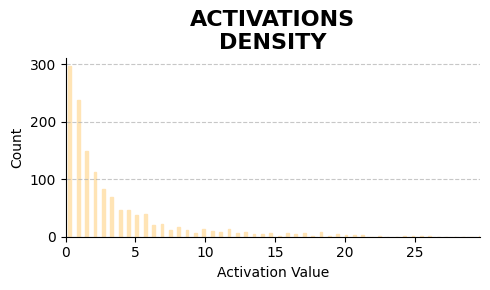

In [7]:
plot = create_activation_density_plot(75)
plt.show()

In [8]:
import matplotlib.pyplot as plt
import numpy as np

def create_logit_histogram(feature_index):
    # Extract the relevant data
    x_values = batch_data['features'][feature_index]['logits_hist_data_bar_values']
    y_values = batch_data['features'][feature_index]['logits_hist_data_bar_heights']

    # Create the plot
    fig, ax = plt.subplots(figsize=(5, 3))

    # Split the data into positive and negative values
    positive_mask = np.array(x_values) >= 0
    negative_mask = np.array(x_values) < 0

    # Plot positive values
    ax.bar(np.array(x_values)[positive_mask], 
           np.array(y_values)[positive_mask], 
           width=0.007, 
           color=(0, 0, 1, 0.5),  # Use RGBA tuple instead of string
           align='center')

    # Plot negative values
    ax.bar(np.array(x_values)[negative_mask], 
           np.array(y_values)[negative_mask], 
           width=0.007, 
           color=(1, 0, 0, 0.5),  # Use RGBA tuple instead of string
           align='center')

    # Set the labels and title
    ax.set_xlabel('Logit Value')
    ax.set_ylabel('Count')

    # Set the x-axis limits and ticks
    ax.set_xlim(-0.3, 0.3)
    ax.set_xticks([-0.2, -0.1, 0, 0.1, 0.2, 0.3])

    # Set the y-axis limit
    ax.set_ylim(0, 3000)

    # Remove top and right spines
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    # Add gridlines
    ax.grid(axis='y', linestyle='--', alpha=0.7)

    # Adjust layout
    plt.tight_layout()

    return fig

# Example usage:
# plot = create_logit_histogram(2)
# plt.show()

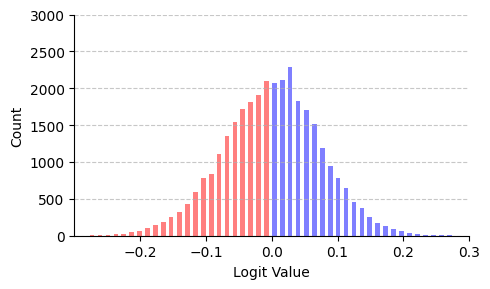

In [9]:
plot = create_logit_histogram(2)
plt.show()

In [10]:
## Calculate Standard Deviations, kurtosis, skewness
# Calculating the weighted mean, standard deviation, kurtosis, and skewness based on the frequency of the values in the histogram


import numpy as np

def calculate_statistics(batch_data, feature_index):
    x_values = np.array(batch_data['features'][feature_index]['logits_hist_data_bar_values'])
    y_values = np.array(batch_data['features'][feature_index]['logits_hist_data_bar_heights'])
    #print(f"feature_index: {batch_data['features'][feature_index]['feature_index']}")
    feature_index = batch_data['features'][feature_index]['feature_index']


    mask = y_values != 0
    x_values = x_values[mask]
    y_values = y_values[mask]

    # Normalize weights
    y_values = y_values / np.sum(y_values)

    # Weighted mean
    mean = np.sum(x_values * y_values)
    
    # Weighted standard deviation
    std_dev = np.sqrt(np.sum(y_values * (x_values - mean)**2))
    
    # Weighted kurtosis
    kurt = np.sum(y_values * ((x_values - mean) / std_dev)**4) - 3
    
    # Weighted skewness
    skewed = np.sum(y_values * ((x_values - mean) / std_dev)**3)

    return mean, std_dev, kurt, skewed, feature_index


# Example usage:
# mean, std_dev, kurt, skew = calculate_statistics(batch_data, 2)
# print(f"Mean: {mean}, Standard Deviation: {std_dev}, Kurtosis: {kurt}, Skewness: {skew}")

In [11]:
mean, std_dev, kurt, skewed, feature_index = calculate_statistics(batch_data, 2)
print(f"Feature Index: {feature_index}, Mean: {mean}, Standard Deviation: {std_dev}, Kurtosis: {kurt}, Skewness: {skewed}")

Feature Index: 2, Mean: 7.672155688622473e-06, Standard Deviation: 0.07399026125780545, Kurtosis: 0.18126024172965005, Skewness: -0.09479352550078142


In [12]:
def calculate_all_feature_stats(batch_data):
    all_feature_stats = []

    for feature in range(len(batch_data['features'])):
        mean, std_dev, kurt, skewed, feature_index = calculate_statistics(batch_data, feature)
        feature_stats = {
            feature_index: {
                'mean': mean,
                'std_dev': std_dev,
                'kurtosis': kurt,
                'skewness': skewed
            }
        }
        all_feature_stats.append(feature_stats)
    
    return all_feature_stats

def print_feature_stats(all_feature_stats, num_features=5):
    print(f"Statistics for the first {num_features} features:")
    for stat in all_feature_stats[:num_features]:
        for idx, values in stat.items():
            print(f"Feature {idx}:")
            for key, value in values.items():
                print(f"  {key}: {value:.4f}")
            print()

# Calculate statistics for all features
all_feature_stats = calculate_all_feature_stats(batch_data)

# Print the first few entries to verify
print_feature_stats(all_feature_stats)


Statistics for the first 5 features:
Feature 0:
  mean: 0.0002
  std_dev: 0.0689
  kurtosis: 0.1932
  skewness: 0.0946

Feature 1:
  mean: -0.0000
  std_dev: 0.0690
  kurtosis: 0.3579
  skewness: 0.0848

Feature 2:
  mean: 0.0000
  std_dev: 0.0740
  kurtosis: 0.1813
  skewness: -0.0948

Feature 3:
  mean: -0.0000
  std_dev: 0.0850
  kurtosis: 0.1835
  skewness: -0.1117

Feature 4:
  mean: 0.0001
  std_dev: 0.0692
  kurtosis: 0.6076
  skewness: 0.1477



In [13]:
import plotly.graph_objects as go
import pandas as pd

def create_skewness_kurtosis_plot(data):
    # Extract data from all_feature_stats
    data = pd.DataFrame([
        {
            'skewness': list(stat.values())[0]['skewness'],
            'kurtosis': list(stat.values())[0]['kurtosis'],
            'std_dev': list(stat.values())[0]['std_dev'],
            'feature_index': list(stat.keys())[0]
        }
        for stat in data
    ])

    # Create the interactive scatter plot
    fig = go.Figure(data=go.Scatter(
        x=data['skewness'],
        y=data['kurtosis'],
        mode='markers',
        marker=dict(
            size=8,
            color=data['std_dev'],
            colorscale='Viridis',
            colorbar=dict(title='Standard Deviation'),
            showscale=True
        ),
        text=data['feature_index'],
        hovertemplate='Feature Index: %{text}<br>Skewness: %{x:.2f}<br>Kurtosis: %{y:.2f}<br>Std Dev: %{marker.color:.2f}<extra></extra>'
    ))

    # Customize the layout
    fig.update_layout(
        title='Skewness vs Kurtosis of the Logit Weight Distribution',
        xaxis_title='Skewness',
        yaxis_title='Kurtosis',
        width=800,
        height=600,
        template='plotly_white'
    )

    # Set the axis limits to match the previous plot
    fig.update_xaxes(range=[-1, 4])
    fig.update_yaxes(range=[-1, 20])

    return fig

plot = create_skewness_kurtosis_plot(all_feature_stats)
plot.show()


#### Load all 768 json files and create the plot for it
Path for all files: /proj/neuronpedia_outputs/microsoft/Phi-3-mini-4k-instruct_local_blocks.16.hook_resid_post/


In [14]:
import os
import json
from tqdm import tqdm


folder_path = '/proj/neuronpedia_outputs/microsoft/Phi-3-mini-4k-instruct_local_blocks.16.hook_resid_post/'
total_features_stats = []

# Get all JSON files in the folder
json_files = [f for f in os.listdir(folder_path) if f.endswith('.json')]

# Loop over all JSON files
for file_name in tqdm(json_files, desc="Processing JSON files"):
    file_path = os.path.join(folder_path, file_name)
    
    # Load the JSON data
    with open(file_path, 'r') as file:
        data = json.load(file)
    
    try:
        # Calculate stats for all features in the file
        file_stats = calculate_all_feature_stats(data)
        
        # Extend the list with the results for each feature
        total_features_stats.extend(file_stats)
    except KeyError as e:
        print(f"KeyError in file {file_name}: {str(e)}")
        print(f"Keys in data: {data.keys()}")
        continue

print(f"Processed {len(json_files)} files. Total features: {len(total_features_stats)}")


Processing JSON files:   0%|          | 0/770 [00:00<?, ?it/s]

Processing JSON files:  87%|████████▋ | 669/770 [01:59<00:13,  7.40it/s]

KeyError in file run_settings.json: 'features'
Keys in data: dict_keys(['sae_set', 'sae_path', 'outputs_dir', 'np_set_name', 'from_local_sae', 'sparsity_threshold', 'huggingface_dataset_path', 'n_prompts_total', 'n_tokens_in_prompt', 'n_prompts_in_forward_pass', 'n_features_at_a_time', 'quantile_feature_batch_size', 'start_batch', 'end_batch', 'n_quantiles', 'top_acts_group_size', 'quantile_group_size', 'use_dfa', 'model_dtype', 'sae_dtype', 'model_id', 'layer', 'sae_device', 'activation_store_device', 'model_device', 'model_n_devices', 'use_wandb', 'shuffle_tokens'])


Processing JSON files:  97%|█████████▋| 750/770 [02:15<00:02,  7.18it/s]

KeyError in file skipped_indexes.json: 'features'
Keys in data: dict_keys(['model_id', 'layer', 'sae_set', 'log_sparsity', 'skipped_indexes'])


Processing JSON files: 100%|██████████| 770/770 [02:19<00:00,  5.54it/s]

Processed 770 files. Total features: 98304


In [19]:
plot = create_skewness_kurtosis_plot(total_features_stats)
plot.show()

## Aditional Statistics about the features

In [42]:
import json
from IPython.display import HTML
# Load the JSON data

feature_index = 110

def create_html_table(title, headers, rows):
    html = f"<h3>{title}</h3>"
    html += "<table border='1'>"
    html += "<tr>" + "".join(f"<th>{header}</th>" for header in headers) + "</tr>"
    for row in rows:
        html += "<tr>" + "".join(f"<td>{cell}</td>" for cell in row) + "</tr>"
    html += "</table>"
    return html

# Neuron Alignment
neuron_alignment = [
    (index, f"+{value:.3f}", f"{l1:.1f}%")
    for index, value, l1 in zip(
        batch_data['features'][feature_index]['neuron_alignment_indices'],
        batch_data['features'][feature_index]['neuron_alignment_values'],
        batch_data['features'][feature_index]['neuron_alignment_l1']
    )
]

# Correlated Neurons
correlated_neurons = [
    (index, f"+{pearson:.3f}", f"+{cosine:.3f}")
    for index, pearson, cosine in zip(
        batch_data['features'][feature_index]['correlated_neurons_indices'],
        batch_data['features'][feature_index]['correlated_neurons_pearson'],
        batch_data['features'][feature_index]['correlated_neurons_l1']
    )
]

# Correlated Features
correlated_features = [
    (index, f"+{pearson:.3f}", f"+{cosine:.3f}")
    for index, pearson, cosine in zip(
        batch_data['features'][feature_index]['correlated_features_indices'],
        batch_data['features'][feature_index]['correlated_features_pearson'],
        batch_data['features'][feature_index]['correlated_features_l1']
    )
]

# Create HTML tables
tables_html = (
    create_html_table("NEURON ALIGNMENT", ["Index", "Value", "% of L1"], neuron_alignment) +
    create_html_table("CORRELATED NEURONS", ["Index", "Pearson Corr.", "Cosine Sim."], correlated_neurons) +
    create_html_table("CORRELATED FEATURES", ["Index", "Pearson Corr.", "Cosine Sim."], correlated_features)
)

# Display the HTML tables
display(HTML(tables_html))

Index,Value,% of L1
2046,+0.527,0.0%
1134,+0.171,0.0%
1671,+0.117,0.0%
Index,Pearson Corr.,Cosine Sim.
17,+0.032,+0.030
930,+0.029,+0.029
2410,+0.027,+0.024
Index,Pearson Corr.,Cosine Sim.
31,+0.011,+0.012
114,+0.002,+0.002


## Generate Automatic Features with OpenAI

### Automatic Feature identification:

1. Take the given activation text and send it to a model: Prompt "How would you label the following data. The goal is to describe the topic the model is activating on these data. Each token has an activation value in brakets the higher the value the more does it activate on it.  What sentence / keywords could describe this activation pattern best?"
2. Taken Topic Description and Simulate Generation with Activattion: "Now try to make examples about how generated text including activaiton numbers could look like if you get the description "Technical Version Numbers and Specifications". Make 5 examples"
3. Calculate Score ... see Paper: https://openaipublic.blob.core.windows.net/neuron-explainer/paper/index.html#sec-algorithm-explain


In [71]:
import openai
import jinja2

def analyze_feature_activations(feature_index, api_key, shorten_text=True, top_activations=True):
    # Initialize the OpenAI client
    client = openai.OpenAI(api_key=api_key)

    # Get activation text
    activation_text = display_feature_activations_with_values(feature_index, shorten_text=shorten_text, top_activations=top_activations, return_html=False)

    # Define the prompt template
    prompt_template = jinja2.Template("""
    How would you label the following data? There should be only on label for all examples. The goal is to describe the topic the model is activating on these data. Each token has an activation value in brackets; the higher the value, the more it activates on it. If all are 0.0 don't label it. What sentence or keywords could best describe this activation pattern?

    {{ activation_text }}
    """)

    # Render the prompt with the activation text
    prompt = prompt_template.render(activation_text=activation_text)

    # Make the API call
    response = client.chat.completions.create(
        model="gpt-4o-2024-08-06",
        messages=[
            {"role": "system", "content": "You are a helpful assistant analyzing model activations. All examples are examples of topic. Each topic can have multiple tags, but there must be a short desctiption max. 5 words to describe the topic. You only respond in json in the following format: {topic: <topic_tags>, description: <topic_description>}"},
            {"role": "user", "content": prompt}
        ]
    )

    # Extract and save the result
    result = response.choices[0].message.content

    #print(f"OpenAI's response: {result}")
    return result

# Example usage:
# api_key = "your_api_key_here"
# result = analyze_feature_activations(2, api_key)


In [73]:
api_key = "<key>"

result = analyze_feature_activations(0, api_key)
result

'```json\n{\n  "topic": ["data_software", "qualitative_analysis"],\n  "description": "Atlas.ti software version reference"\n}\n```'

In [74]:
import pickle
from tqdm import tqdm

# Initialize an empty list to store all responses
all_responses = []

# Iterate through the range of feature indices (0-127)
for feature_index in tqdm(range(128), desc="Analyzing features"):
    try:
        # Analyze feature activations and append the result to the list
        result = analyze_feature_activations(feature_index, api_key)
        all_responses.append({feature_index: result})
    except Exception as e:
        print(f"Error processing feature {feature_index}: {str(e)}")
        all_responses.append({feature_index: f"Error: {str(e)}"})

# Save the list to disk as a pickle file
output_file = "feature_activation_analysis.pkl"
with open(output_file, "wb") as f:
    pickle.dump(all_responses, f)

print(f"Analysis complete. Results saved to {output_file}")


Analyzing features: 100%|██████████| 128/128 [01:45<00:00,  1.22it/s]

Analysis complete. Results saved to feature_activation_analysis.pkl


In [75]:
all_responses

[{0: '```json\n{"topic": ["Atlas.ti_Version"], "description": "Atlas.ti software version references"}\n```'},
 {1: '```json\n{\n  "topic": ["wildlife", "conservation", "endangered-species"],\n  "description": "Mountain gorillas and cheetahs"\n}\n```'},
 {2: '{}'},
 {3: '{}'},
 {4: '```json\n{\n  "topic": ["dependence", "reliance"],\n  "description": "Relying on critical elements"\n}\n```'},
 {5: '```json\n{\n  "topic": ["identification"],\n  "description": "Identification process importance"\n}\n```'},
 {6: '```json\n{"topic": ["user_interaction", "feedback"], "description": "User engagement metrics"}\n```'},
 {7: '{}'},
 {8: '{}'},
 {9: '{}'},
 {10: '```json\n{}\n```'},
 {11: '```json\n{\n  "topic": ["Computer Architecture", "Registers"],\n  "description": "Discussion of computer registers."\n}\n```'},
 {12: '```json\n{\n  "topic": ["personal_pronouns", "future_plans", "actions"],\n  "description": "Personal reflections and actions"\n}\n```'},
 {13: '```json\n{\n  "topic": ["years", "